# Import Library

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Data manipulation
import pandas as pd
import numpy as np

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Modeling - LightGBM
import lightgbm as lgb
from lightgbm import LGBMClassifier

# Modeling - Evaluation
from sklearn.metrics import (
    roc_auc_score, roc_curve, classification_report, silhouette_score
)

# Modeling - Preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import (
    RobustScaler, StandardScaler, MinMaxScaler, MaxAbsScaler,
    Normalizer, QuantileTransformer, KBinsDiscretizer,
    OneHotEncoder, FunctionTransformer
)
from sklearn.impute import SimpleImputer

# Feature selection
from sklearn.feature_selection import mutual_info_classif

# Oversampling techniques
from imblearn.over_sampling import (
    RandomOverSampler, SMOTE, BorderlineSMOTE,
    SVMSMOTE, ADASYN
)

# Pipelines and transformations
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

# Clustering
from sklearn.cluster import KMeans

# Model explainability
import shap

from sklearn.metrics import classification_report, confusion_matrix
from scipy.stats import ttest_ind
from sklearn.decomposition import PCA
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant


# Data Wrangling

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Data Quest SOLO Goes To GoTo/Data Quest Materials/training_dataset.csv')
df.set_index('customer_number', inplace=True)
display(df)

,usia,pekerjaan,status_perkawinan,pendidikan,gagal_bayar_sebelumnya,pinjaman_rumah,pinjaman_pribadi,jenis_kontak,bulan_kontak_terakhir,hari_kontak_terakhir,...,hari_sejak_kontak_sebelumnya,jumlah_kontak_sebelumnya,hasil_kampanye_sebelumnya,tingkat_variasi_pekerjaan,indeks_harga_konsumen,indeks_kepercayaan_konsumen,suku_bunga_euribor_3bln,jumlah_pekerja,pulau,berlangganan_deposito
customer_number,,,,,,,,,,,,,,,,,,,,,
531036,63,sosial media specialis,menikah,Pendidikan Tinggi,no,yes,no,cellular,jul,fri,...,999,0,nonexistent,-1.7,94.215,-40.3,0.885,4991.6,Papua,1
999241,43,teknisi,menikah,Pendidikan Tinggi,no,yes,no,cellular,nov,fri,...,999,0,nonexistent,-0.1,93.200,-42.0,4.021,5195.8,Sulawesi,0
995002,29,sosial media specialis,lajang,Pendidikan Tinggi,no,yes,yes,cellular,jul,thu,...,999,0,nonexistent,1.4,93.918,-42.7,4.958,5228.1,Papua,0
932750,40,pekerja kasar,menikah,SMA,no,no,no,telephone,may,wed,...,999,0,nonexistent,1.1,93.994,-36.4,4.859,5191.0,Sumatera,1
684699,40,sosial media specialis,lajang,Pendidikan Tinggi,no,no,no,cellular,aug,wed,...,999,0,nonexistent,1.4,93.444,-36.1,4.964,5228.1,Bali,0
687725,34,manajer,cerai,Pendidikan Tinggi,no,yes,no,telephone,may,tue,...,999,0,nonexistent,1.1,93.994,-36.4,4.856,5191.0,Sumatera,0
884790,31,sosial media specialis,lajang,Pendidikan Tinggi,no,yes,yes,cellular,jul,fri,...,999,0,nonexistent,1.4,93.918,-42.7,4.957,5228.1,NTT,0
138535,29,asisten rumah tangga,menikah,SMA,no,no,no,telephone,may,fri,...,999,0,nonexistent,1.1,93.994,-36.4,4.864,5191.0,Sumatera,0
300611,37,sosial media specialis,cerai,Pendidikan Tinggi,no,unknown,unknown,telephone,may,wed,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,Sumatera,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22916 entries, 531036 to 977067
Data columns (total 21 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   usia                          22916 non-null  int64  
 1   pekerjaan                     22916 non-null  object 
 2   status_perkawinan             22916 non-null  object 
 3   pendidikan                    22916 non-null  object 
 4   gagal_bayar_sebelumnya        22916 non-null  object 
 5   pinjaman_rumah                22916 non-null  object 
 6   pinjaman_pribadi              22916 non-null  object 
 7   jenis_kontak                  22916 non-null  object 
 8   bulan_kontak_terakhir         22916 non-null  object 
 9   hari_kontak_terakhir          22916 non-null  object 
 10  jumlah_kontak_kampanye_ini    22916 non-null  int64  
 11  hari_sejak_kontak_sebelumnya  22916 non-null  int64  
 12  jumlah_kontak_sebelumnya      22916 non-null  int64  
 13  

# Exploratory Data Analysis (EDA)

In [ ]:
numerical_columns = df.select_dtypes(include=['number']).columns
categorical_columns = df.select_dtypes(include=['object']).columns

print(f'Numerical Columns: {list(numerical_columns)}')
print(f'Categorical Columns: {list(categorical_columns)}')

Numerical Columns: ['usia', 'jumlah_kontak_kampanye_ini', 'hari_sejak_kontak_sebelumnya', 'jumlah_kontak_sebelumnya', 'tingkat_variasi_pekerjaan', 'indeks_harga_konsumen', 'indeks_kepercayaan_konsumen', 'suku_bunga_euribor_3bln', 'jumlah_pekerja', 'berlangganan_deposito']
Categorical Columns: ['pekerjaan', 'status_perkawinan', 'pendidikan', 'gagal_bayar_sebelumnya', 'pinjaman_rumah', 'pinjaman_pribadi', 'jenis_kontak', 'bulan_kontak_terakhir', 'hari_kontak_terakhir', 'hasil_kampanye_sebelumnya', 'pulau']


## Karakteristik Nasabah

In [ ]:
kolom_nasabah = ['usia', 'pekerjaan', 'status_perkawinan', 'pendidikan',
                 'gagal_bayar_sebelumnya', 'pinjaman_rumah', 'pinjaman_pribadi']

df_nasabah = df[kolom_nasabah + ['berlangganan_deposito']]
for kolom in kolom_nasabah:
    print(f"\n-----------------{kolom}-----------------")
    display(df_nasabah.groupby('berlangganan_deposito')[kolom].describe())


-----------------usia-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,39.873707,9.917368,17.0,32.0,38.0,47.0,95.0
1,2614.0,41.123183,13.782471,18.0,31.0,37.0,50.0,98.0



-----------------pekerjaan-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,12,sosial media specialis,5006
1,2614,12,sosial media specialis,749



-----------------status_perkawinan-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,4,menikah,12411
1,2614,4,menikah,1447



-----------------pendidikan-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,8,Pendidikan Tinggi,5773
1,2614,8,Pendidikan Tinggi,926



-----------------gagal_bayar_sebelumnya-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,3,no,15803
1,2614,2,no,2366



-----------------pinjaman_rumah-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,3,yes,10651
1,2614,3,yes,1402



-----------------pinjaman_pribadi-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,3,no,16744
1,2614,3,no,2144


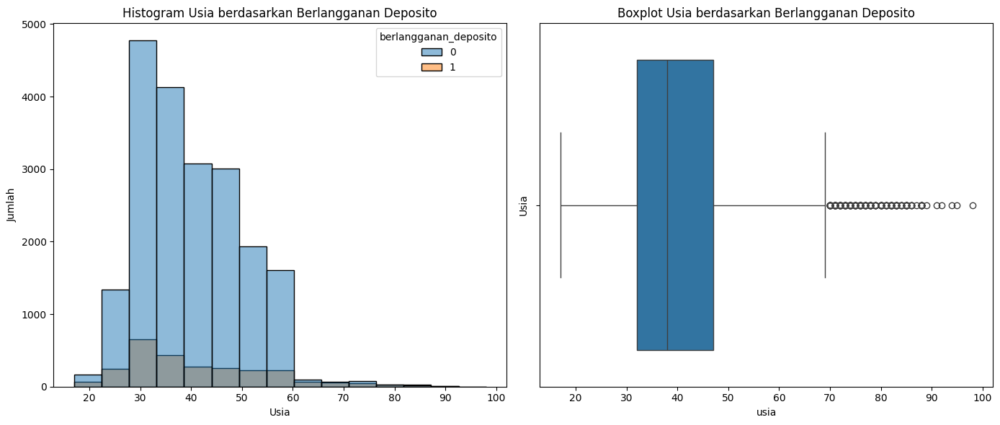

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

sns.histplot(data=df_nasabah, x='usia', hue='berlangganan_deposito', bins=15, kde=False, ax=ax[0], alpha=0.5)
ax[0].set_title('Histogram Usia berdasarkan Berlangganan Deposito')
ax[0].set_xlabel('Usia')
ax[0].set_ylabel('Jumlah')

sns.boxplot(data=df_nasabah, x='usia', ax=ax[1])
ax[1].set_title('Boxplot Usia berdasarkan Berlangganan Deposito')
ax[1].set_ylabel('Usia')

plt.tight_layout()
plt.show()

In [ ]:
def features_mean_difference(df, features, target_col, alpha=0.05):
    """
    Performs t-test for each numeric feature to compare means between two classes of the target.

    Parameters:
    - df: pandas.DataFrame containing the data
    - features: list of column names (numeric features) to test
    - target_col: name of the binary target column (values 0/1)
    - alpha: significance level (default 0.05)

    Returns:
    - results_df: DataFrame with columns:
        'feature', 't_statistic', 'p_value', 'significant', 'mean_class_0', 'mean_class_1'
    """
    results = []
    class0 = df[df[target_col] == 0]
    class1 = df[df[target_col] == 1]

    for feat in features:
        # Drop NaN values
        x0 = class0[feat].dropna()
        x1 = class1[feat].dropna()

        # Perform t-test
        t_stat, p_val = ttest_ind(x0, x1, equal_var=False)

        results.append({
            'feature': feat,
            't_statistic': t_stat,
            'p_value': p_val,
            'significant': p_val < alpha,
            'mean_class_0': x0.mean(),
            'mean_class_1': x1.mean()
        })

    results_df = pd.DataFrame(results)
    # Sort by p-value ascending
    results_df = results_df.sort_values('p_value').reset_index(drop=True)
    return results_df

In [ ]:
features_mean_difference(df, ['usia'], 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,usia,-4.48786,0.000007,True,39.873707,41.123183


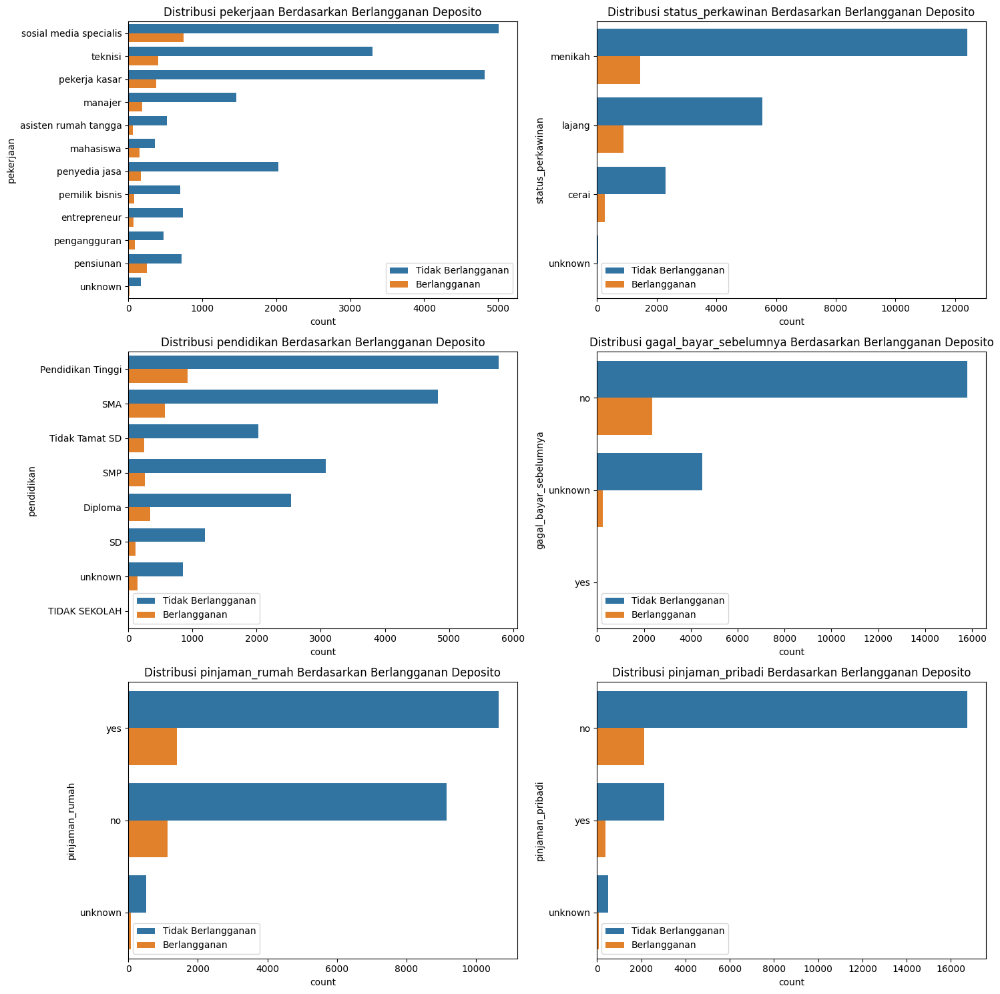

In [ ]:
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(15, 15))
for i, kolom in enumerate(kolom_nasabah[1:]):
    sns.countplot(y=kolom, hue='berlangganan_deposito', data=df_nasabah, ax=ax[i//2, i%2])
    ax[i//2, i%2].set_title(f'Distribusi {kolom} Berdasarkan Berlangganan Deposito')
    ax[i//2, i%2].legend(['Tidak Berlangganan', 'Berlangganan'])
plt.tight_layout()

## Kampanye Saat Ini

In [ ]:
kolom_kampanye_saat_ini = ['jenis_kontak', 'bulan_kontak_terakhir', 'hari_kontak_terakhir',
                           'jumlah_kontak_kampanye_ini', 'hari_sejak_kontak_sebelumnya',]

df_kampanye_saat_ini = df[kolom_kampanye_saat_ini + ['berlangganan_deposito']]
for kolom in kolom_kampanye_saat_ini:
    print(f"\n-----------------{kolom}-----------------")
    display(df_kampanye_saat_ini.groupby('berlangganan_deposito')[kolom].describe())


-----------------jenis_kontak-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,2,cellular,12343
1,2614,2,cellular,2180



-----------------bulan_kontak_terakhir-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,10,may,7112
1,2614,10,may,499



-----------------hari_kontak_terakhir-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,5,thu,4244
1,2614,5,thu,584



-----------------jumlah_kontak_kampanye_ini-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,2.631662,2.906042,1.0,1.0,2.0,3.0,42.0
1,2614.0,2.019893,1.588921,1.0,1.0,1.0,2.0,17.0



-----------------hari_sejak_kontak_sebelumnya-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,984.133041,120.584819,0.0,999.0,999.0,999.0,999.0
1,2614.0,791.944912,403.510579,0.0,999.0,999.0,999.0,999.0


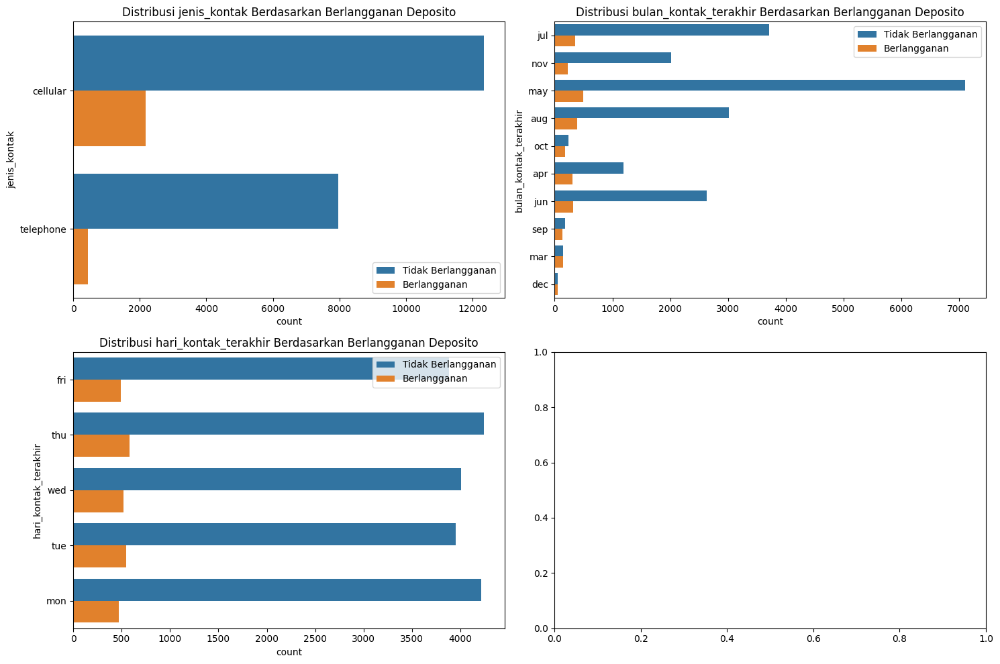

In [ ]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(15, 10))
for i, kolom in enumerate(kolom_kampanye_saat_ini[:3]):
    sns.countplot(y=kolom, hue='berlangganan_deposito', data=df_kampanye_saat_ini, ax=ax[i//2, i%2])
    ax[i//2, i%2].set_title(f'Distribusi {kolom} Berdasarkan Berlangganan Deposito')
    ax[i//2, i%2].legend(['Tidak Berlangganan', 'Berlangganan'])
plt.tight_layout()

<ipython-input-2092-bbbc5cc8d448>:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[0, i].legend(title='Berlangganan')
<ipython-input-2092-bbbc5cc8d448>:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[0, i].legend(title='Berlangganan')


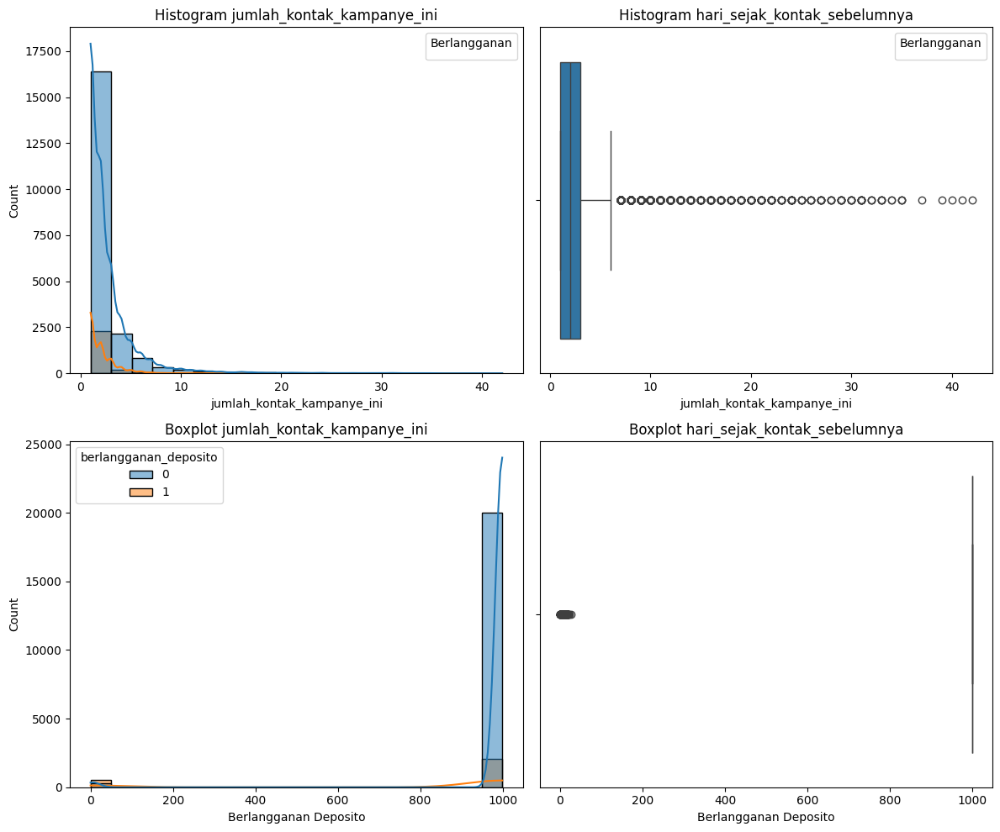

In [ ]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(6 * 2, 10))
for i, kolom in enumerate(kolom_kampanye_saat_ini[3:]):
    sns.histplot(x=kolom, hue='berlangganan_deposito', data=df_kampanye_saat_ini, ax=ax[i, 0], bins=20, kde=True)
    ax[0, i].set_title(f'Histogram {kolom}')
    ax[0, i].legend(title='Berlangganan')

    sns.boxplot(x=kolom, data=df_kampanye_saat_ini, ax=ax[i, 1])
    ax[1, i].set_title(f'Boxplot {kolom}')
    ax[1, i].set_xlabel('Berlangganan Deposito')

plt.tight_layout()
plt.show()

In [ ]:
features_mean_difference(df, ['jumlah_kontak_kampanye_ini'], 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,jumlah_kontak_kampanye_ini,16.457541,2.261962e-59,True,2.631662,2.019893


In [ ]:
features_mean_difference(df.loc[df['hari_sejak_kontak_sebelumnya'] != 999], ['hari_sejak_kontak_sebelumnya'], 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,hari_sejak_kontak_sebelumnya,0.899207,0.368894,False,6.141447,5.895413


## Riwayat Kampanye Sebelumnya

In [ ]:
kolom_riwayat_kampanye = ['jumlah_kontak_sebelumnya', 'hasil_kampanye_sebelumnya']

df_riwayat_kampanye = df[kolom_riwayat_kampanye + ['berlangganan_deposito']]
for kolom in kolom_riwayat_kampanye:
    print(f"\n-----------------{kolom}-----------------")
    display(df_riwayat_kampanye.groupby('berlangganan_deposito')[kolom].describe())


-----------------jumlah_kontak_sebelumnya-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,0.129445,0.407422,0.0,0.0,0.0,0.0,7.0
1,2614.0,0.486228,0.841655,0.0,0.0,0.0,1.0,5.0



-----------------hasil_kampanye_sebelumnya-----------------


,count,unique,top,freq
berlangganan_deposito,,,,
0,20302,3,nonexistent,18066
1,2614,3,nonexistent,1770


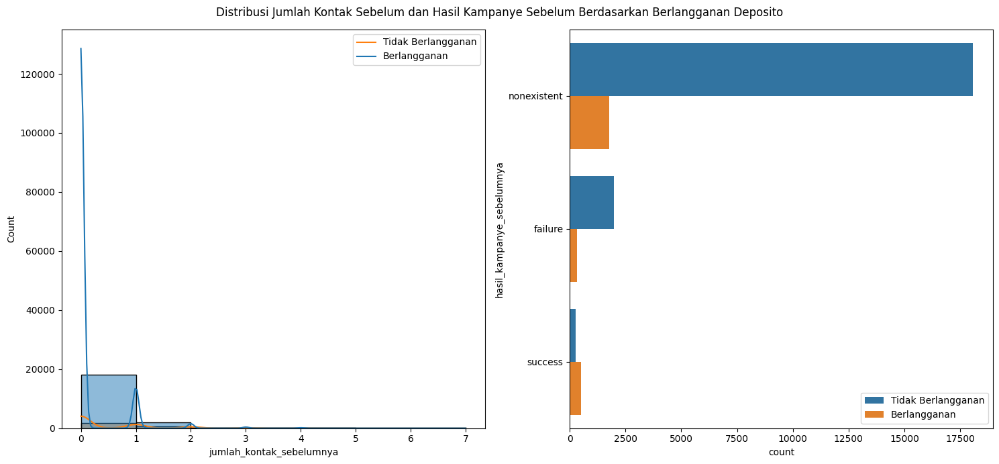

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 7))
plt.suptitle('Distribusi Jumlah Kontak Sebelum dan Hasil Kampanye Sebelum Berdasarkan Berlangganan Deposito')
sns.histplot(x='jumlah_kontak_sebelumnya', hue='berlangganan_deposito', data=df_riwayat_kampanye, ax=ax[0], bins=7, kde=True)
sns.countplot(y='hasil_kampanye_sebelumnya', hue='berlangganan_deposito', data=df_riwayat_kampanye, ax=ax[1])
ax[0].legend(['Tidak Berlangganan', 'Berlangganan'])
ax[1].legend(['Tidak Berlangganan', 'Berlangganan'])
plt.tight_layout()
plt.show()

In [ ]:
features_mean_difference(df, ['jumlah_kontak_sebelumnya'], 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,jumlah_kontak_sebelumnya,-21.353441,8.670647e-94,True,0.129445,0.486228


In [ ]:
def total_kontak(row):
  if row['hasil_kampanye_sebelumnya'] == 'success':
    return row['jumlah_kontak_sebelumnya']
  else:
    return row['jumlah_kontak_sebelumnya'] + row['jumlah_kontak_kampanye_ini']

df['total_jumlah_kontak_sampai_berhasil'] = df.apply(total_kontak, axis=1)

display(df[['jumlah_kontak_sebelumnya', 'jumlah_kontak_kampanye_ini', 'hasil_kampanye_sebelumnya', 'total_jumlah_kontak_sampai_berhasil']].sample(10))

,jumlah_kontak_sebelumnya,jumlah_kontak_kampanye_ini,hasil_kampanye_sebelumnya,total_jumlah_kontak_sampai_berhasil
customer_number,,,,
796380,0,1,nonexistent,1
156099,0,2,nonexistent,2
781276,0,1,nonexistent,1
395728,0,2,nonexistent,2
476368,0,10,nonexistent,10
566951,0,1,nonexistent,1
131068,0,1,nonexistent,1
955776,0,3,nonexistent,3
496430,0,1,nonexistent,1


In [ ]:
df.drop('jumlah_kontak_kampanye_ini', inplace=True, axis=1)

In [ ]:
features_mean_difference(df, ['total_jumlah_kontak_sampai_berhasil'], 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,total_jumlah_kontak_sampai_berhasil,14.801508,1.475713e-48,True,2.735445,2.172533


## Indikator Ekonomi

In [ ]:
kolom_ekonomi = ['tingkat_variasi_pekerjaan', 'indeks_harga_konsumen',
                 'indeks_kepercayaan_konsumen', 'suku_bunga_euribor_3bln',
                 'jumlah_pekerja']

df_ekonomi = df[kolom_ekonomi + ['berlangganan_deposito']]
for kolom in kolom_ekonomi:
    print(f"\n-----------------{kolom}-----------------")
    display(df_ekonomi.groupby('berlangganan_deposito')[kolom].describe())


-----------------tingkat_variasi_pekerjaan-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,0.248527,1.486687,-3.4,-1.8,1.1,1.4,1.4
1,2614.0,-1.247169,1.622374,-3.4,-1.8,-1.8,-0.1,1.4



-----------------indeks_harga_konsumen-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,93.606360,0.559702,92.201,93.075,93.918,93.994,94.767
1,2614.0,93.344945,0.679456,92.201,92.893,93.200,93.918,94.767



-----------------indeks_kepercayaan_konsumen-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,-40.582145,4.400791,-50.8,-42.7,-41.8,-36.4,-26.9
1,2614.0,-39.736802,6.147792,-50.8,-46.2,-40.4,-36.1,-26.9



-----------------suku_bunga_euribor_3bln-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,3.811887,1.639944,0.634,1.405,4.857,4.962,5.045
1,2614.0,2.111179,1.737599,0.634,0.849,1.266,4.191,5.045



-----------------jumlah_pekerja-----------------


,count,mean,std,min,25%,50%,75%,max
berlangganan_deposito,,,,,,,,
0,20302.0,5176.000995,64.853695,4963.6,5099.1,5195.8,5228.1,5228.1
1,2614.0,5095.103558,87.131895,4963.6,5017.5,5099.1,5191.0,5228.1


<ipython-input-2102-dd2d3ee5564f>:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[i, 0].legend(title='Berlangganan')
<ipython-input-2102-dd2d3ee5564f>:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[i, 0].legend(title='Berlangganan')
<ipython-input-2102-dd2d3ee5564f>:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[i, 0].legend(title='Berlangganan')
<ipython-input-2102-dd2d3ee5564f>:5: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[i, 0].legend(title='Berlangganan')
<ipython-inp

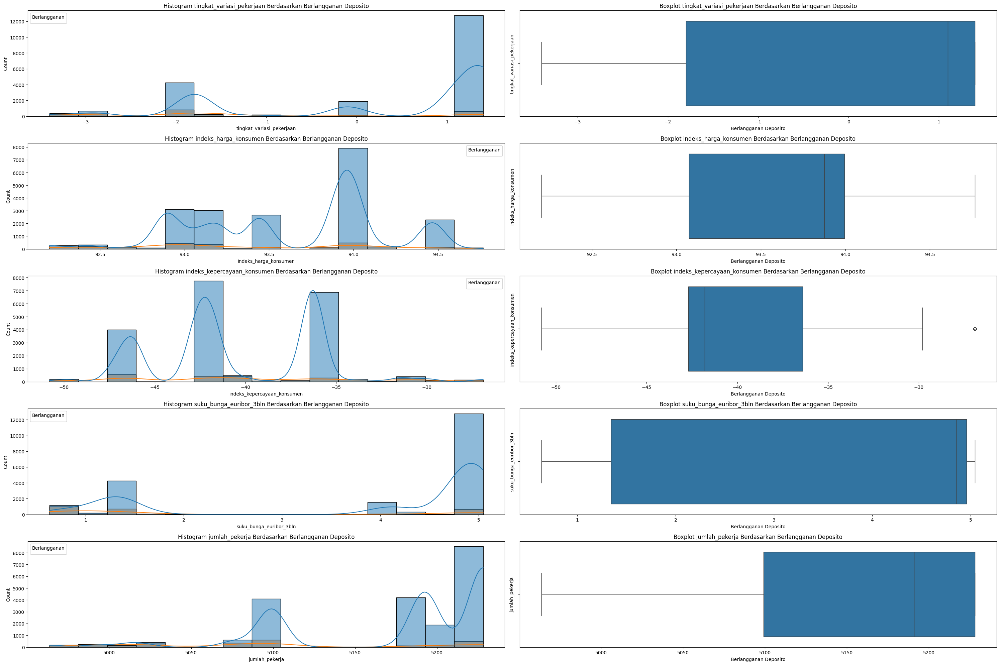

In [ ]:
fig, ax = plt.subplots(nrows=5, ncols=2, figsize=(6 * 5, 20))
for i, kolom in enumerate(kolom_ekonomi):
    sns.histplot(x=kolom, hue='berlangganan_deposito', data=df_ekonomi, ax=ax[i, 0], bins=15, kde=True)
    ax[i, 0].set_title(f'Histogram {kolom} Berdasarkan Berlangganan Deposito')
    ax[i, 0].legend(title='Berlangganan')

    sns.boxplot(x=kolom, data=df_ekonomi, ax=ax[i, 1])
    ax[i, 1].set_title(f'Boxplot {kolom} Berdasarkan Berlangganan Deposito')
    ax[i, 1].set_xlabel('Berlangganan Deposito')
    ax[i, 1].set_ylabel(kolom)

plt.tight_layout()
plt.show()

In [ ]:
features_mean_difference(df, kolom_ekonomi, 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,tingkat_variasi_pekerjaan,44.776676,0.000000e+00,True,0.248527,-1.247169
1,suku_bunga_euribor_3bln,47.397552,0.000000e+00,True,3.811887,2.111179
2,jumlah_pekerja,45.861520,0.000000e+00,True,5176.000995,5095.103558
3,indeks_harga_konsumen,18.864004,3.280529e-75,True,93.606360,93.344945
4,indeks_kepercayaan_konsumen,-6.809146,1.183583e-11,True,-40.582145,-39.736802


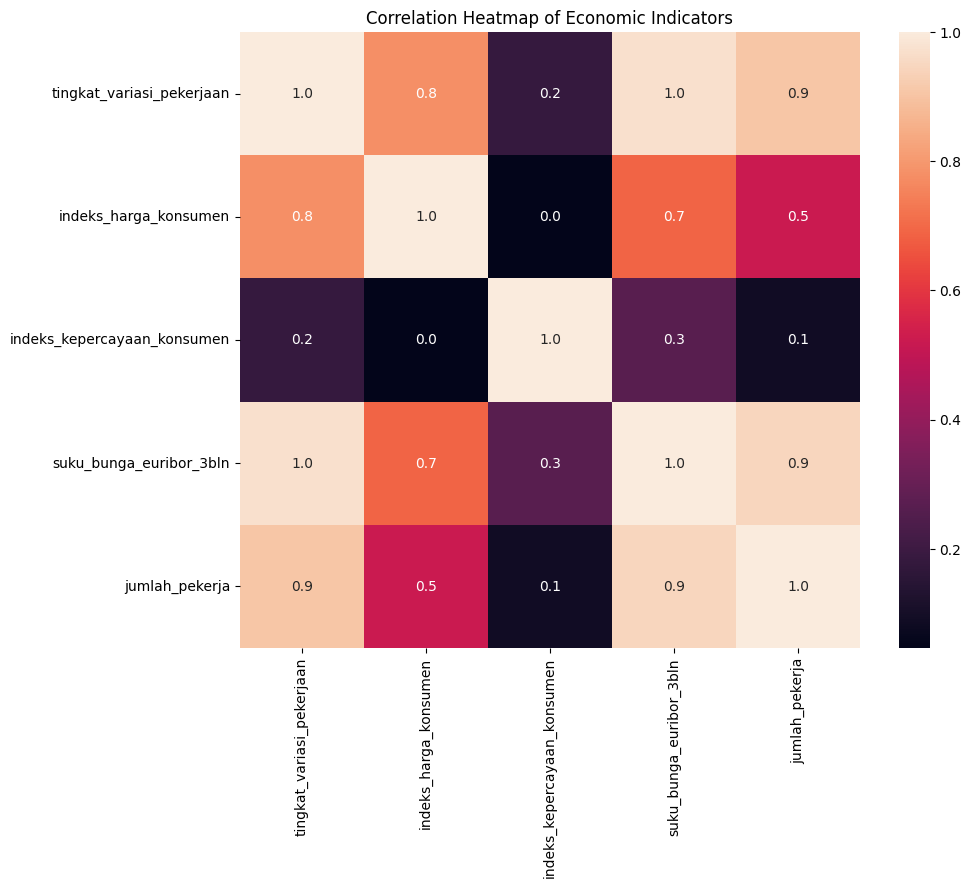

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(df[kolom_ekonomi].corr(), annot=True, fmt='.1f')
plt.title('Correlation Heatmap of Economic Indicators')
plt.show()

In [ ]:
df.groupby(['bulan_kontak_terakhir', 'berlangganan_deposito']).agg({kol: 'mean' for kol in kolom_ekonomi})

tingkat_variasi_pekerjaan  \
bulan_kontak_terakhir berlangganan_deposito                              
apr                   0                                      -1.800000   
                      1                                      -1.800000   
aug                   0                                       0.926386   
                      1                                      -0.982995   
dec                   0                                      -2.688889   
                      1                                      -2.941667   
jul                   0                                       1.249852   
                      1                                       0.118414   
jun                   0                                       0.901442   
                      1                                      -1.199065   
mar                   0                                      -1.800000   
                      1                                      -1.800000   
may                   0                                      -0.082916   
                      1                                      -1.027054   
nov                   0                                      -0.293710   
                      1                                      -1.609130   
oct                   0                                      -2.515063   
                      1                                      -2.287912   
sep                   0                                      -2.313889   
                      1                                      -2.040146   

                                             indeks_harga_konsumen  \
bulan_kontak_terakhir berlangganan_deposito                          
apr                   0                                  93.098144   
                      1                                  93.183710   
aug                   0                                  93.339002   
                      1                                  93.032952   
dec                   0                                  92.717778   
                      1                                  92.713896   
jul                   0                                  93.895256   
                      1                                  93.850997   
jun                   0                                  94.309486   
                      1                                  93.699673   
mar                   0                                  93.069973   
                      1                                  93.143571   
may                   0                                  93.551396   
                      1                                  93.312529   
nov                   0                                  93.200292   
                      1                                  93.151574   
oct                   0                                  93.149000   
                      1                                  93.259522   
sep                   0                                  93.238444   
                      1                                  93.455058   

                                             indeks_kepercayaan_konsumen  \
bulan_kontak_terakhir berlangganan_deposito                                
apr                   0                                       -46.670771   
                      1                                       -45.083871   
aug                   0                                       -35.702887   
                      1                                       -34.544924   
dec                   0                                       -34.433333   
                      1                                       -33.268750   
jul                   0                                       -42.468617   
                      1                                       -41.119263   
jun                   0                                       -41.648634   
                      1                

In [ ]:
df[categorical_columns] = df[categorical_columns].applymap(lambda x: x.lower() if isinstance(x, str) else x)

for kolom in categorical_columns:
    print(f"\n-----------------{kolom}-----------------")
    print(df[kolom].unique())


-----------------pekerjaan-----------------
['sosial media specialis' 'teknisi' 'pekerja kasar' 'manajer'
 'asisten rumah tangga' 'mahasiswa' 'penyedia jasa' 'pemilik bisnis'
 'entrepreneur' 'pengangguran' 'pensiunan' 'unknown']

-----------------status_perkawinan-----------------
['menikah' 'lajang' 'cerai' 'unknown']

-----------------pendidikan-----------------
['pendidikan tinggi' 'sma' 'tidak tamat sd' 'smp' 'diploma' 'sd' 'unknown'
 'tidak sekolah']

-----------------gagal_bayar_sebelumnya-----------------
['no' 'unknown' 'yes']

-----------------pinjaman_rumah-----------------
['yes' 'no' 'unknown']

-----------------pinjaman_pribadi-----------------
['no' 'yes' 'unknown']

-----------------jenis_kontak-----------------
['cellular' 'telephone']

-----------------bulan_kontak_terakhir-----------------
['jul' 'nov' 'may' 'aug' 'oct' 'apr' 'jun' 'sep' 'mar' 'dec']

-----------------hari_kontak_terakhir-----------------
['fri' 'thu' 'wed' 'tue' 'mon']

-----------------hasil_kampan

<ipython-input-2106-0079f87f16b1>:1: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df[categorical_columns] = df[categorical_columns].applymap(lambda x: x.lower() if isinstance(x, str) else x)


## Fitur Lainnya

<function matplotlib.pyplot.ylabel(ylabel: 'str', fontdict: 'dict[str, Any] | None' = None, labelpad: 'float | None' = None, *, loc: "Literal['bottom', 'center', 'top'] | None" = None, **kwargs) -> 'Text'>

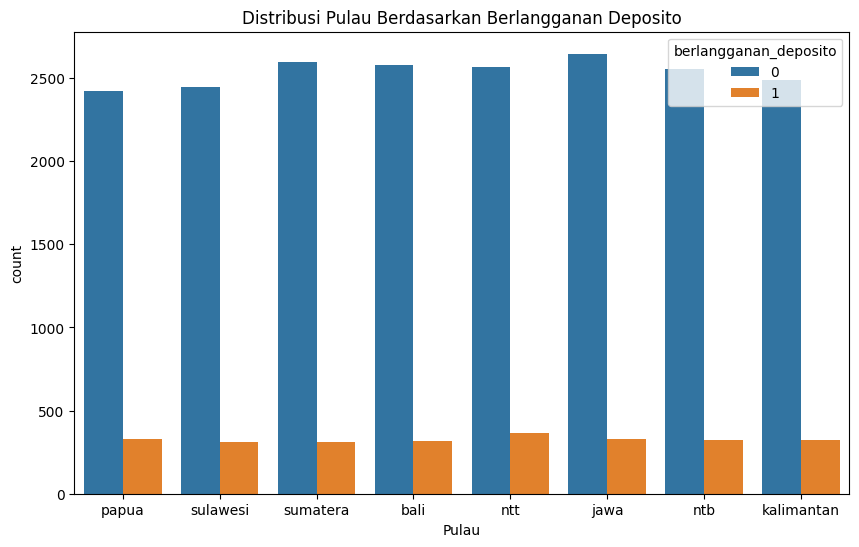

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='pulau', hue='berlangganan_deposito', data=df)
plt.title('Distribusi Pulau Berdasarkan Berlangganan Deposito')
plt.xlabel('Pulau')
plt.ylabel

In [ ]:
df.groupby(['pulau', 'berlangganan_deposito']).agg({kol: 'mean' for kol in kolom_ekonomi})

tingkat_variasi_pekerjaan  \
pulau      berlangganan_deposito                              
bali       0                                       0.225505   
           1                                      -1.201893   
jawa       0                                       0.267196   
           1                                      -1.270948   
kalimantan 0                                       0.240361   
           1                                      -1.255247   
ntb        0                                       0.219945   
           1                                      -1.300920   
ntt        0                                       0.277873   
           1                                      -1.144262   
papua      0                                       0.217788   
           1                                      -1.363526   
sulawesi   0                                       0.274213   
           1                                      -1.236013   
sumatera   0                                       0.263790   
           1                                      -1.213057   

                                  indeks_harga_konsumen  \
pulau      berlangganan_deposito                          
bali       0                                  93.598467   
           1                                  93.410735   
jawa       0                                  93.604809   
           1                                  93.406495   
kalimantan 0                                  93.597131   
           1                                  93.315009   
ntb        0                                  93.595440   
           1                                  93.354393   
ntt        0                                  93.625067   
           1                                  93.325191   
papua      0                                  93.602992   
           1                                  93.303556   
sulawesi   0                                  93.612263   
           1                                  93.331707   
sumatera   0                                  93.614467   
           1                                  93.315013   

                                  indeks_kepercayaan_konsumen  \
pulau      berlangganan_deposito                                
bali       0                                       -40.565800   
           1                                       -39.166877   
jawa       0                                       -40.536546   
           1                                       -40.446789   
kalimantan 0                                       -40.620281   
           1                                       -39.287654   
ntb        0                                       -40.571412   
           1                                       -39.875153   
ntt        0                                       -40.561200   
           1                                       -39.836885   
papua      0                                       -40.657615   
           1                                       -39.737386   
sulawesi   0                                       -40.536984   
           1                                       -39.692283   
sumatera   0                                       -40.611672   
           1                                       -39.819427   

                                  suku_bunga_euribor_3bln  jumlah_pekerja  
pulau      berlangganan_deposito                                           
bali       0                                     3.776019     5174.386762  
           1                                     2.135025     5092.647634  
jawa       0                                     3.846854     5177.758050  
           1                                     2.006370     5087.567278  
kalimantan 0                                     3.809825     5176.219157  
           1                                     2.110367     5095.202160  
ntb        0                                     3.785141

# Features Engineering

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df.drop('berlangganan_deposito', axis=1), df['berlangganan_deposito'],
                                                    test_size=0.2, random_state=42,
                                                    stratify=df.berlangganan_deposito)

print(f'X_train shape: {X_train.shape}')
print(f'X_test shape: {X_test.shape}')
print(f'y_train shape: {y_test.shape}')
print(f'y_test shape: {y_test.shape}')

X_train shape: (18332, 20)
X_test shape: (4584, 20)
y_train shape: (4584,)
y_test shape: (4584,)


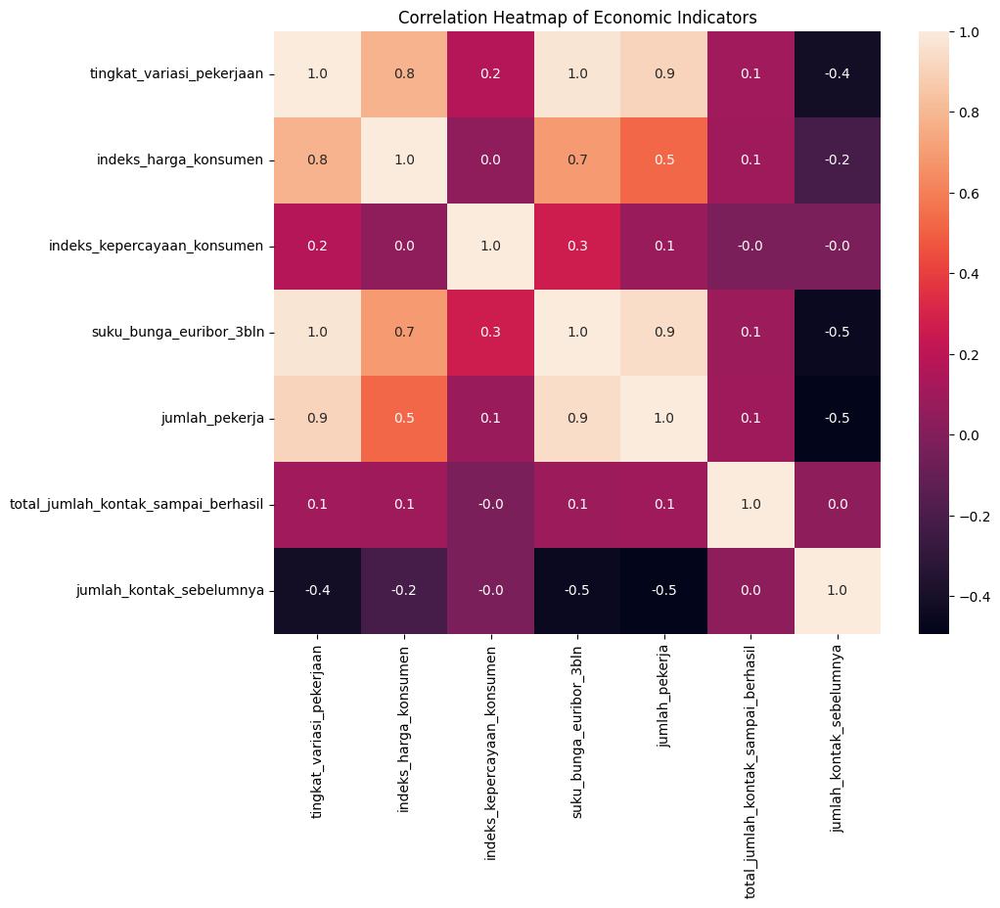

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(X_train[kolom_ekonomi + ['total_jumlah_kontak_sampai_berhasil', 'jumlah_kontak_sebelumnya']].corr(), annot=True, fmt='.1f')
plt.title('Correlation Heatmap of Economic Indicators')
plt.show()

## Imputasi Nilai 'Unknown'

In [ ]:
kolom_imput = ['status_perkawinan', 'pendidikan', 'gagal_bayar_sebelumnya', 'pinjaman_rumah', 'pinjaman_pribadi', 'pekerjaan']

def replace_unknown(X):
    return X.replace('unknown', np.nan)

unknown_imputer = SimpleImputer(strategy='most_frequent')

X_train[kolom_imput] = replace_unknown(X_train[kolom_imput])
X_train_imputed = pd.DataFrame(
    unknown_imputer.fit_transform(X_train[kolom_imput]),
    columns=kolom_imput,
    index=X_train.index
)
X_train[kolom_imput] = X_train_imputed


X_test[kolom_imput] = replace_unknown(X_test[kolom_imput])
X_test_imputed = pd.DataFrame(
    unknown_imputer.transform(X_test[kolom_imput]),
    columns=kolom_imput,
    index=X_test.index
)
X_test[kolom_imput] = X_test_imputed

display(X_train[kolom_imput].head())

,status_perkawinan,pendidikan,gagal_bayar_sebelumnya,pinjaman_rumah,pinjaman_pribadi,pekerjaan
customer_number,,,,,,
527546,menikah,pendidikan tinggi,no,no,no,manajer
247513,menikah,tidak tamat sd,no,yes,no,pekerja kasar
663996,cerai,sma,no,no,no,entrepreneur
589551,menikah,pendidikan tinggi,no,yes,no,sosial media specialis
873510,lajang,sd,no,yes,no,pekerja kasar


## Encode Bins

In [ ]:
kolom_bin_encd = ['usia']
binning = KBinsDiscretizer(encode='ordinal', strategy='quantile')

X_train[kolom_bin_encd] = binning.fit_transform(X_train[kolom_bin_encd])
X_test[kolom_bin_encd] = binning.transform(X_test[kolom_bin_encd])

display(X_train[kolom_bin_encd].head())

,usia
customer_number,
527546,2.0
247513,4.0
663996,4.0
589551,3.0
873510,1.0


## Encode Frekuensi

In [ ]:
mask_valid = X_train['hasil_kampanye_sebelumnya'].isin(['success', 'failure'])
job_success = X_train[mask_valid & (X_train['hasil_kampanye_sebelumnya'] == 'success')].groupby('pekerjaan').size()
job_total = X_train[mask_valid].groupby('pekerjaan').size()
success_rate_pekerjaan_map = (job_success / job_total).fillna(0).to_dict()

X_train['success_rate_pekerjaan'] = X_train['pekerjaan'].map(success_rate_pekerjaan_map)
X_test['success_rate_pekerjaan'] = X_test['pekerjaan'].map(success_rate_pekerjaan_map)

display(X_train[['pekerjaan', 'success_rate_pekerjaan']].sample(10))

,pekerjaan,success_rate_pekerjaan
customer_number,,
443997,pensiunan,0.424731
612629,pekerja kasar,0.108108
336962,pekerja kasar,0.108108
902939,pekerja kasar,0.108108
499806,sosial media specialis,0.287407
456703,pekerja kasar,0.108108
918241,sosial media specialis,0.287407
501129,sosial media specialis,0.287407
392486,manajer,0.208122


In [ ]:
usia_success = X_train[mask_valid & (X_train['hasil_kampanye_sebelumnya'] == 'success')].groupby('usia').size()
usia_total = X_train[mask_valid].groupby('usia').size()
success_rate_usia_map = (usia_success / usia_total).fillna(0).to_dict()

X_train['success_rate_usia'] = X_train['usia'].map(success_rate_usia_map)
X_test['success_rate_usia'] = X_test['usia'].map(success_rate_usia_map)

display(X_train[['usia', 'success_rate_usia']].sample(10))

,usia,success_rate_usia
customer_number,,
896641,2.0,0.191489
804724,3.0,0.167526
498897,4.0,0.328383
116501,4.0,0.328383
653229,0.0,0.294455
328489,4.0,0.328383
291394,2.0,0.191489
488547,4.0,0.328383
132188,0.0,0.294455


In [ ]:
jenis_kontak_success = X_train[mask_valid & (X_train['hasil_kampanye_sebelumnya'] == 'success')].groupby('jenis_kontak').size()
jenis_kontak_total = X_train[mask_valid].groupby('jenis_kontak').size()
success_rate_jenis_kontak_map = (jenis_kontak_success / jenis_kontak_total).fillna(0).to_dict()

X_train['success_rate_jenis_kontak'] = X_train['jenis_kontak'].map(success_rate_jenis_kontak_map)
X_test['success_rate_jenis_kontak'] = X_test['jenis_kontak'].map(success_rate_jenis_kontak_map)

display(X_train[['jenis_kontak', 'success_rate_jenis_kontak']].sample(10))

,jenis_kontak,success_rate_jenis_kontak
customer_number,,
508333,cellular,0.241184
262470,cellular,0.241184
146091,telephone,0.272189
184558,telephone,0.272189
425086,cellular,0.241184
742692,cellular,0.241184
895132,cellular,0.241184
151837,cellular,0.241184
240287,cellular,0.241184


In [ ]:
kolom_freq_encd = ['pekerjaan', 'bulan_kontak_terakhir', 'hari_kontak_terakhir','status_perkawinan', 'pendidikan',]
freq_maps = {}

for col in kolom_freq_encd:
    # Buat mapping frequensi
    freq = X_train[col].value_counts()
    freq_maps[col] = freq

    # Simpan kolom asli
    X_train[f'{col}_freq'] = X_train[col].map(freq)
    X_test[f'{col}_freq'] = X_test[col].map(freq_maps[col])

# Tampilkan hasil encoding
display(X_train[[f'{col}_freq' for col in kolom_freq_encd]].head())


,pekerjaan_freq,bulan_kontak_terakhir_freq,hari_kontak_terakhir_freq,status_perkawinan_freq,pendidikan_freq
customer_number,,,,,
527546,1339,6080,3892,11131,6146
247513,4204,6080,3766,11131,1852
663996,656,6080,3766,2061,4310
589551,4785,2368,3892,11131,6146
873510,4204,6080,3766,5140,1053


In [ ]:
kolom_hasil_encd_freq = ['success_rate_pekerjaan', 'success_rate_usia', 'success_rate_jenis_kontak',
                         'pekerjaan_freq', 'bulan_kontak_terakhir_freq', 'hari_kontak_terakhir_freq', 'pendidikan_freq']

features_mean_difference(pd.concat([X_train, y_train], axis=1), kolom_hasil_encd_freq, 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,success_rate_jenis_kontak,25.468397,4.110100e-130,True,0.253368,0.246285
1,bulan_kontak_terakhir_freq,22.345534,2.393848e-101,True,3683.101595,2676.430894
2,success_rate_pekerjaan,-15.793804,1.003301e-53,True,0.221592,0.256013
3,success_rate_usia,-11.966009,3.591367e-32,True,0.232605,0.250800
4,pendidikan_freq,-6.766419,1.619975e-11,True,3964.417277,4246.680536
5,pekerjaan_freq,5.926343,3.513016e-09,True,3070.010467,2833.613582
6,hari_kontak_terakhir_freq,0.161590,8.716414e-01,False,3671.790099,3671.253467


## Tranformasi Trigonometri

In [ ]:
map_bulan = {
    'jan': 1,
    'feb': 2,
    'mar': 3,
    'apr': 4,
    'may': 5,
    'jun': 6,
    'jul': 7,
    'aug': 8,
    'sep': 9,
    'oct': 10,
    'nov': 11,
    'dec': 12
}

X_train['sin_bulan_kontak_terakhir'] = np.sin(2 * np.pi * X_train['bulan_kontak_terakhir'].map(map_bulan) / 12)
X_train['cos_bulan_kontak_terakhir'] = np.cos(2 * np.pi * X_train['bulan_kontak_terakhir'].map(map_bulan) / 12)

X_test['sin_bulan_kontak_terakhir'] = np.sin(2 * np.pi * X_test['bulan_kontak_terakhir'].map(map_bulan) / 12)
X_test['cos_bulan_kontak_terakhir'] = np.cos(2 * np.pi * X_test['bulan_kontak_terakhir'].map(map_bulan) / 12)

display(X_train[['bulan_kontak_terakhir', 'sin_bulan_kontak_terakhir', 'cos_bulan_kontak_terakhir']].head())

,bulan_kontak_terakhir,sin_bulan_kontak_terakhir,cos_bulan_kontak_terakhir
customer_number,,,
527546,may,5.000000e-01,-0.866025
247513,may,5.000000e-01,-0.866025
663996,may,5.000000e-01,-0.866025
589551,jun,1.224647e-16,-1.000000
873510,may,5.000000e-01,-0.866025


In [ ]:
map_hari = {
    'mon': 1,
    'tue': 2,
    'wed': 3,
    'thu': 4,
    'fri': 5
}

X_train['sin_hari_kontak_terakhir'] = np.sin(2 * np.pi * X_train['hari_kontak_terakhir'].map(map_hari) / 5)
X_train['cos_hari_kontak_terakhir'] = np.cos(2 * np.pi * X_train['hari_kontak_terakhir'].map(map_hari) / 5)

X_test['sin_hari_kontak_terakhir'] = np.sin(2 * np.pi * X_test['hari_kontak_terakhir'].map(map_hari) / 5)
X_test['cos_hari_kontak_terakhir'] = np.cos(2 * np.pi * X_test['hari_kontak_terakhir'].map(map_hari) / 5)

display(X_train[['bulan_kontak_terakhir', 'sin_hari_kontak_terakhir', 'cos_hari_kontak_terakhir']].head())

,bulan_kontak_terakhir,sin_hari_kontak_terakhir,cos_hari_kontak_terakhir
customer_number,,,
527546,may,-0.951057,0.309017
247513,may,0.951057,0.309017
663996,may,0.951057,0.309017
589551,jun,-0.951057,0.309017
873510,may,0.951057,0.309017


In [ ]:
kolom_hasil_trigonoimetri = ['sin_bulan_kontak_terakhir', 'cos_bulan_kontak_terakhir', 'sin_hari_kontak_terakhir', 'cos_hari_kontak_terakhir']

features_mean_difference(pd.concat([X_train, y_train], axis=1), kolom_hasil_trigonoimetri, 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,cos_bulan_kontak_terakhir,-13.523424,2.688073e-40,True,-0.599809,-0.411480
1,sin_bulan_kontak_terakhir,2.961627,3.088967e-03,True,-0.054423,-0.100110
2,sin_hari_kontak_terakhir,1.260102,2.077431e-01,False,-0.005341,-0.026226
3,cos_hari_kontak_terakhir,1.164656,2.442631e-01,False,0.008832,-0.010126


## OneHotEncoder

In [ ]:
kolom_ohe = ['pinjaman_pribadi', 'pinjaman_rumah', 'pulau']

ohe = OneHotEncoder(handle_unknown='ignore', drop='first')

X_train_ohe = pd.DataFrame(
    ohe.fit_transform(X_train[kolom_ohe]).toarray(),
    columns=ohe.get_feature_names_out(kolom_ohe),
    index=X_train.index
)
X_train = X_train.drop(kolom_ohe, axis=1).join(X_train_ohe)

X_test_ohe = pd.DataFrame(
    ohe.transform(X_test[kolom_ohe]).toarray(),
    columns=ohe.get_feature_names_out(kolom_ohe),
    index=X_test.index
)
X_test = X_test.drop(kolom_ohe, axis=1).join(X_test_ohe)

display(X_train.head())

,usia,pekerjaan,status_perkawinan,pendidikan,gagal_bayar_sebelumnya,jenis_kontak,bulan_kontak_terakhir,hari_kontak_terakhir,hari_sejak_kontak_sebelumnya,jumlah_kontak_sebelumnya,...,cos_hari_kontak_terakhir,pinjaman_pribadi_yes,pinjaman_rumah_yes,pulau_jawa,pulau_kalimantan,pulau_ntb,pulau_ntt,pulau_papua,pulau_sulawesi,pulau_sumatera
customer_number,,,,,,,,,,,,,,,,,,,,,
527546,2.0,manajer,menikah,pendidikan tinggi,no,cellular,may,thu,999,0,...,0.309017,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
247513,4.0,pekerja kasar,menikah,tidak tamat sd,no,telephone,may,mon,999,0,...,0.309017,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
663996,4.0,entrepreneur,cerai,sma,no,telephone,may,mon,999,0,...,0.309017,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
589551,3.0,sosial media specialis,menikah,pendidikan tinggi,no,telephone,jun,thu,999,0,...,0.309017,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
873510,1.0,pekerja kasar,lajang,sd,no,cellular,may,mon,999,0,...,0.309017,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


## Enceode Ordinal

In [ ]:
map_pendidikan = {
    'tidak sekolah': -1,
    'tidak tamat sd': 0,
    'sd': 0,
    'smp': 1,
    'sma': 1,
    'diploma': 2,
    'pendidikan tinggi': 2,
}

X_train['pendidikan'] = X_train['pendidikan'].map(map_pendidikan)
X_test['pendidikan'] = X_test['pendidikan'].map(map_pendidikan)

display(X_train['pendidikan'].head())

,pendidikan
customer_number,
527546,2
247513,0
663996,1
589551,2
873510,0


In [ ]:
map_hasil_kampanye_sebelumnya = {
    'failure': -1,
    'nonexistent': 1,
    'success': 0,
}

X_train['hasil_kampanye_sebelumnya'] = X_train['hasil_kampanye_sebelumnya'].map(map_hasil_kampanye_sebelumnya)
X_test['hasil_kampanye_sebelumnya'] = X_test['hasil_kampanye_sebelumnya'].map(map_hasil_kampanye_sebelumnya)

display(X_train['hasil_kampanye_sebelumnya'].head())

,hasil_kampanye_sebelumnya
customer_number,
527546,1
247513,1
663996,1
589551,1
873510,1


## Generate Fitur Baru

In [ ]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18332 entries, 527546 to 506445
Data columns (total 38 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   usia                                 18332 non-null  float64
 1   pekerjaan                            18332 non-null  object 
 2   status_perkawinan                    18332 non-null  object 
 3   pendidikan                           18332 non-null  int64  
 4   gagal_bayar_sebelumnya               18332 non-null  object 
 5   jenis_kontak                         18332 non-null  object 
 6   bulan_kontak_terakhir                18332 non-null  object 
 7   hari_kontak_terakhir                 18332 non-null  object 
 8   hari_sejak_kontak_sebelumnya         18332 non-null  int64  
 9   jumlah_kontak_sebelumnya             18332 non-null  int64  
 10  hasil_kampanye_sebelumnya            18332 non-null  int64  
 11  tingkat_variasi_pekerjaan  

In [ ]:
X_train['nasabah_baru'] = X_train['hari_sejak_kontak_sebelumnya'].apply(lambda x: 1 if x == 999 else 0)
X_test['nasabah_baru'] = X_test['hari_sejak_kontak_sebelumnya'].apply(lambda x: 1 if x == 999 else 0)

display(X_train[['hari_sejak_kontak_sebelumnya', 'nasabah_baru']].sample(10))

,hari_sejak_kontak_sebelumnya,nasabah_baru
customer_number,,
802180,999,1
407923,999,1
273713,999,1
646023,999,1
489996,999,1
401416,999,1
320542,999,1
804214,999,1
626094,999,1


In [ ]:
X_train['hari_sejak_kontak_sebelumnya'] = X_train['hari_sejak_kontak_sebelumnya'].replace(999, -1)
X_test['hari_sejak_kontak_sebelumnya'] = X_test['hari_sejak_kontak_sebelumnya'].replace(999, -1)

display(X_train['hari_sejak_kontak_sebelumnya'].sample(10))

,hari_sejak_kontak_sebelumnya
customer_number,
959370,-1
285251,-1
599512,-1
502747,-1
641652,-1
384345,-1
982126,-1
906664,-1
731801,-1


In [ ]:
pca_cols = ['jumlah_pekerja', 'suku_bunga_euribor_3bln',
            'tingkat_variasi_pekerjaan', 'indeks_harga_konsumen']

pca = PCA(n_components=1)
X_train['econ_pc1'] = pca.fit_transform(X_train[pca_cols])
X_test['econ_pc1'] = pca.transform(X_test[pca_cols])

display(X_train[['econ_pc1']].head())

,econ_pc1
customer_number,
527546,-67.603346
247513,24.397560
663996,24.397560
589551,61.488597
873510,-67.602599


In [ ]:
# hasil_agg = X_train.groupby(['bulan_kontak_terakhir']).agg({kol: 'mean' for kol in kolom_ekonomi})

# for kol in kolom_ekonomi:
#     X_train[kol] = X_train['bulan_kontak_terakhir'].map(hasil_agg[kol])
#     X_test[kol]  = X_test['bulan_kontak_terakhir'].map(hasil_agg[kol]) \
#                      .fillna(hasil_agg[kol].mean())

# display(X_train[kolom_ekonomi].head())

In [ ]:
features_mean_difference(pd.concat([X_train, y_train], axis=1), kolom_ekonomi + ['econ_pc1'], 'berlangganan_deposito')

,feature,t_statistic,p_value,significant,mean_class_0,mean_class_1
0,suku_bunga_euribor_3bln,42.892729,2.151107e-304,True,3.812242,2.099049
1,econ_pc1,41.308008,2.522954e-282,True,9.230545,-71.694541
2,jumlah_pekerja,41.302534,2.910089e-282,True,5175.868124,5094.975610
3,tingkat_variasi_pekerjaan,40.532297,4.915659e-278,True,0.248020,-1.263941
4,indeks_harga_konsumen,17.829105,5.484580e-67,True,93.607796,93.332951
5,indeks_kepercayaan_konsumen,-5.800561,7.491446e-09,True,-40.554947,-39.744524


In [ ]:
X_train.drop(columns=pca_cols, inplace=True)
X_test.drop(columns=pca_cols, inplace=True)

In [ ]:
X_train.drop(columns=X_train.select_dtypes(include='object').columns, inplace=True)
X_test.drop(columns=X_test.select_dtypes(include='object').columns, inplace=True)

# Modeling

## LGBMClassifier

In [ ]:
X_train.columns

Index(['usia', 'pendidikan', 'hari_sejak_kontak_sebelumnya',
       'jumlah_kontak_sebelumnya', 'hasil_kampanye_sebelumnya',
       'indeks_kepercayaan_konsumen', 'total_jumlah_kontak_sampai_berhasil',
       'success_rate_pekerjaan', 'success_rate_usia',
       'success_rate_jenis_kontak', 'pekerjaan_freq',
       'bulan_kontak_terakhir_freq', 'hari_kontak_terakhir_freq',
       'status_perkawinan_freq', 'pendidikan_freq',
       'sin_bulan_kontak_terakhir', 'cos_bulan_kontak_terakhir',
       'sin_hari_kontak_terakhir', 'cos_hari_kontak_terakhir',
       'pinjaman_pribadi_yes', 'pinjaman_rumah_yes', 'pulau_jawa',
       'pulau_kalimantan', 'pulau_ntb', 'pulau_ntt', 'pulau_papua',
       'pulau_sulawesi', 'pulau_sumatera', 'nasabah_baru', 'econ_pc1'],
      dtype='object')

In [ ]:
col_to_use = X_train.columns
excluded = ['hari_sejak_kontak_sebelumnya', 'jumlah_kontak_sebelumnya',
            'status_perkawinan_menikah', 'status_perkawinan_lajang',
            'hari_kontak_terakhir_freq',
            'sin_hari_kontak_terakhir', 'cos_hari_kontak_terakhir',
            ]
col_to_use = [f for f in col_to_use if f not in excluded]

col_to_scale = ['hasil_kampanye_sebelumnya', 'indeks_kepercayaan_konsumen', 'total_jumlah_kontak_sampai_berhasil',
                'econ_pc1', 'success_rate_pekerjaan', 'success_rate_usia', 'success_rate_jenis_kontak',
                'pekerjaan_freq', 'bulan_kontak_terakhir_freq',  'status_perkawinan_freq', 'pendidikan_freq',
                ]

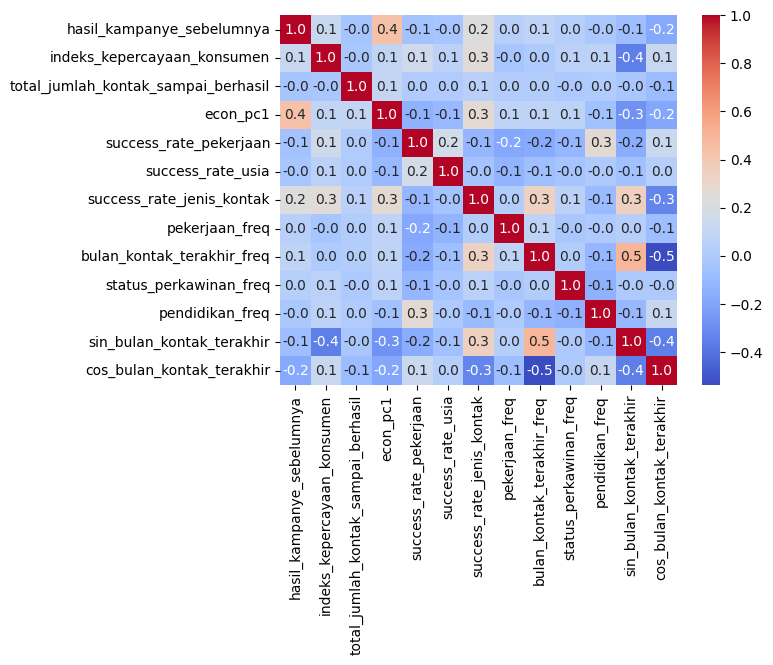

In [ ]:
sns.heatmap(X_train[col_to_scale + ['sin_bulan_kontak_terakhir', 'cos_bulan_kontak_terakhir', ]].corr(), annot=True, cmap="coolwarm", fmt='.1f')
plt.show()

In [ ]:
X_with_const = add_constant(X_train[col_to_use])  # Tambahkan intercept
vif = pd.DataFrame()
vif["feature"] = col_to_use
vif["VIF"] = [variance_inflation_factor(X_with_const.values, i+1) for i in range(len(col_to_use))]  # i+1 karena const di index 0

print(vif)

                                feature       VIF
0                                  usia  1.113876
1                            pendidikan  1.992047
2             hasil_kampanye_sebelumnya  1.325993
3           indeks_kepercayaan_konsumen  1.641897
4   total_jumlah_kontak_sampai_berhasil  1.034795
5                success_rate_pekerjaan  1.246988
6                     success_rate_usia  1.078954
7             success_rate_jenis_kontak  1.831183
8                        pekerjaan_freq  1.067005
9            bulan_kontak_terakhir_freq  1.835814
10               status_perkawinan_freq  1.074545
11                      pendidikan_freq  1.971501
12            sin_bulan_kontak_terakhir  2.576244
13            cos_bulan_kontak_terakhir  1.599165
14                 pinjaman_pribadi_yes  1.002866
15                   pinjaman_rumah_yes  1.010790
16                           pulau_jawa  1.773497
17                     pulau_kalimantan  1.738025
18                            pulau_ntb  1.749450


In [ ]:
def drop_high_vif(X, thresh=5.0):
    Xc = add_constant(X)
    while True:
        vifs = pd.Series(
            [variance_inflation_factor(Xc.values, i+1)
             for i in range(len(X.columns))],
            index=X.columns
        )
        max_vif = vifs.max()
        if max_vif <= thresh:
            break
        drop_feature = vifs.idxmax()
        X = X.drop(columns=[drop_feature])
        Xc = add_constant(X)
    return X

X_train_reduced = drop_high_vif(X_train[col_to_use], thresh=10)

In [ ]:
X_train_reduced.columns

Index(['usia', 'pendidikan', 'hasil_kampanye_sebelumnya',
       'indeks_kepercayaan_konsumen', 'total_jumlah_kontak_sampai_berhasil',
       'success_rate_pekerjaan', 'success_rate_usia',
       'success_rate_jenis_kontak', 'pekerjaan_freq',
       'bulan_kontak_terakhir_freq', 'status_perkawinan_freq',
       'pendidikan_freq', 'sin_bulan_kontak_terakhir',
       'cos_bulan_kontak_terakhir', 'pinjaman_pribadi_yes',
       'pinjaman_rumah_yes', 'pulau_jawa', 'pulau_kalimantan', 'pulau_ntb',
       'pulau_ntt', 'pulau_papua', 'pulau_sulawesi', 'pulau_sumatera',
       'nasabah_baru', 'econ_pc1'],
      dtype='object')

In [ ]:
col_to_use = X_train_reduced.columns

# col_to_scale = ['indeks_kepercayaan_konsumen', 'total_jumlah_kontak_sampai_berhasil',
#                 'econ_pc1', 'success_rate_pekerjaan', 'success_rate_usia', 'pekerjaan_freq',
#                 'bulan_kontak_terakhir_freq', 'status_perkawinan_freq', 'pendidikan_freq']

In [ ]:
Scaler = StandardScaler()

X_train_scaled = X_train.copy()
X_test_scaled = X_test.copy()

X_train_scaled[col_to_scale] = Scaler.fit_transform(X_train_scaled[col_to_scale])
X_test_scaled[col_to_scale] = Scaler.transform(X_test_scaled[col_to_scale])

In [ ]:
X_train_final = X_train_scaled[col_to_use].copy()
X_test_final = X_test_scaled[col_to_use].copy()

# sampler = RandomOverSampler(random_state=42, )
# X_train_resample, y_train_resample = sampler.fit_resample(X_train_final, y_train)

In [ ]:
mi_scores = mutual_info_classif(X_train_final, y_train, random_state=42)

mi_df = pd.DataFrame({
    'Fitur': col_to_use,
    'MI Score': mi_scores
}).sort_values(by='MI Score', ascending=False)

pd.set_option('display.max_rows', None)
print(mi_df)

                                  Fitur  MI Score
24                             econ_pc1  0.073435
3           indeks_kepercayaan_konsumen  0.066605
23                         nasabah_baru  0.037049
2             hasil_kampanye_sebelumnya  0.033366
9            bulan_kontak_terakhir_freq  0.027295
13            cos_bulan_kontak_terakhir  0.022144
12            sin_bulan_kontak_terakhir  0.017351
7             success_rate_jenis_kontak  0.016918
5                success_rate_pekerjaan  0.012218
8                        pekerjaan_freq  0.008585
10               status_perkawinan_freq  0.007047
20                          pulau_papua  0.006091
0                                  usia  0.005030
19                            pulau_ntt  0.004509
11                      pendidikan_freq  0.004023
6                     success_rate_usia  0.002983
4   total_jumlah_kontak_sampai_berhasil  0.002924
1                            pendidikan  0.002765
22                       pulau_sumatera  0.002497


In [ ]:
selected_features = mi_df[mi_df['MI Score'] > 0.01]
selected_features = selected_features['Fitur'].tolist()
excluded = ['sin_bulan_kontak_terakhir', 'cos_bulan_kontak_terakhir', ]
selected_features = [f for f in selected_features if f not in excluded]
print(selected_features)

['econ_pc1', 'indeks_kepercayaan_konsumen', 'nasabah_baru', 'hasil_kampanye_sebelumnya', 'bulan_kontak_terakhir_freq', 'success_rate_jenis_kontak', 'success_rate_pekerjaan']


In [ ]:
model = LGBMClassifier(random_state=42, objective='binary', metric='auc', class_weight='balanced')
model.fit(X_train_final[selected_features], y_train)

[LightGBM] [Info] Number of positive: 2091, number of negative: 16241
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000506 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 200
[LightGBM] [Info] Number of data points in the train set: 18332, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


LGBMClassifier(class_weight='balanced', metric='auc', objective='binary',
               random_state=42)

ROC-AUC Score: 0.7979


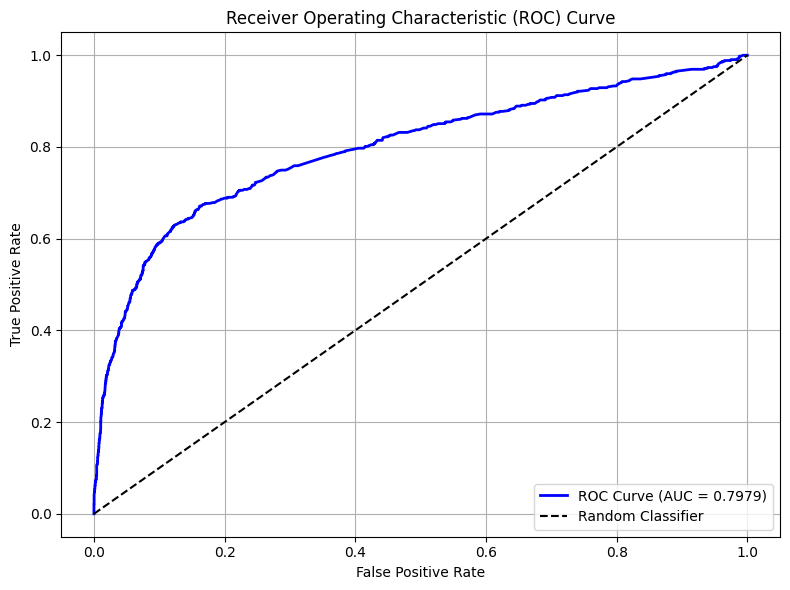

In [ ]:
y_probs = model.predict_proba(X_test_final[selected_features])[:,1]

auc_score = roc_auc_score(y_test, y_probs)
print(f"ROC-AUC Score: {auc_score:.4f}")

fpr, tpr, thresholds = roc_curve(y_test, y_probs)
plt.figure(figsize=(8,6))
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {auc_score:.4f})', color='blue', linewidth=2)
plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
model.score(X_train_final[selected_features], y_train)

0.8324241763037312

=== Classification Report ===
              precision    recall  f1-score   support

           0       0.95      0.86      0.90      4061
           1       0.37      0.64      0.47       523

    accuracy                           0.83      4584
   macro avg       0.66      0.75      0.68      4584
weighted avg       0.88      0.83      0.85      4584

=== Confusion Matrix ===


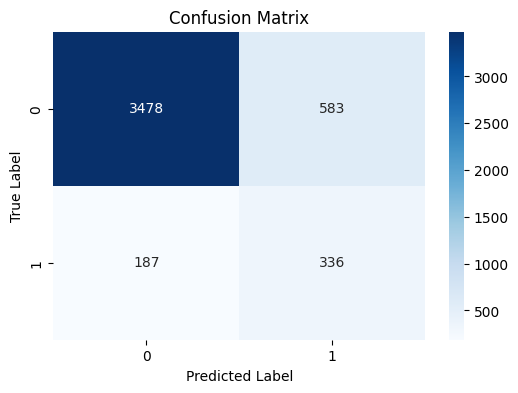

In [ ]:
y_pred = model.predict(X_test_final[selected_features])

print("=== Classification Report ===")
print(classification_report(y_test, y_pred))

cm = confusion_matrix(y_test, y_pred)
print("=== Confusion Matrix ===")
plt.figure(figsize=(6,4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=model.classes_, yticklabels=model.classes_)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

/usr/local/lib/python3.11/dist-packages/shap/explainers/_tree.py:583: UserWarning: LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
  warnings.warn(


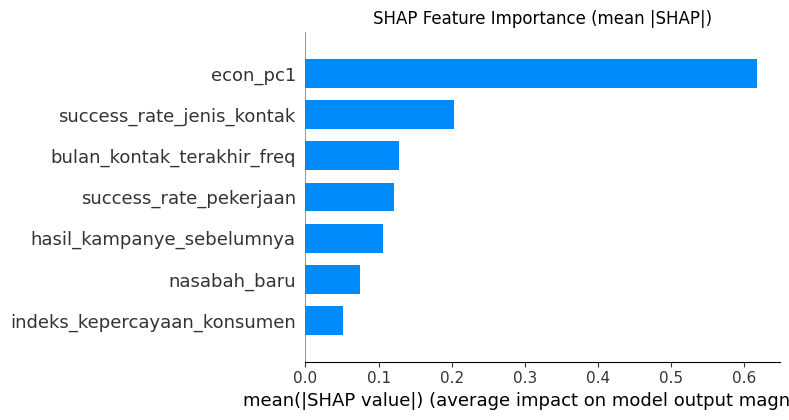

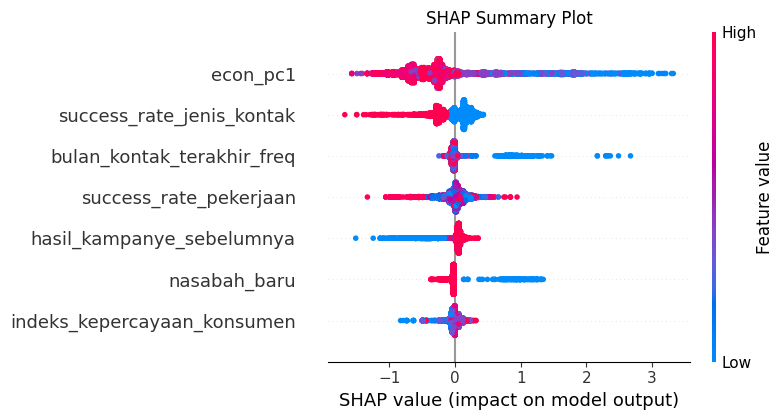

In [ ]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test_final[selected_features])

plt.figure(figsize=(10, 20))
shap.summary_plot(
    shap_values,
    X_test_final[selected_features],
    plot_type="bar",
    show=False,
    max_display=X_test_final[selected_features].shape[1]
)
plt.title("SHAP Feature Importance (mean |SHAP|)")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 8))
shap.summary_plot(
    shap_values,
    X_test_final[selected_features],
    show=False,
    max_display=X_test_final[selected_features].shape[1]

)
plt.title("SHAP Summary Plot")
plt.tight_layout()
plt.show()

# Membuat Prediksi

In [ ]:
X_val = pd.read_csv('/content/drive/MyDrive/Data Quest SOLO Goes To GoTo/Data Quest Materials/validation_set.csv')
X_val[categorical_columns] = X_val[categorical_columns].applymap(lambda x: x.lower() if isinstance(x, str) else x)
X_val.set_index('customer_number', inplace=True)

X_val.head()

<ipython-input-2148-cec66f4efd49>:2: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  X_val[categorical_columns] = X_val[categorical_columns].applymap(lambda x: x.lower() if isinstance(x, str) else x)


,usia,pekerjaan,status_perkawinan,pendidikan,gagal_bayar_sebelumnya,pinjaman_rumah,pinjaman_pribadi,jenis_kontak,bulan_kontak_terakhir,hari_kontak_terakhir,jumlah_kontak_kampanye_ini,hari_sejak_kontak_sebelumnya,jumlah_kontak_sebelumnya,hasil_kampanye_sebelumnya,tingkat_variasi_pekerjaan,indeks_harga_konsumen,indeks_kepercayaan_konsumen,suku_bunga_euribor_3bln,jumlah_pekerja,pulau
customer_number,,,,,,,,,,,,,,,,,,,,
445420,35,penyedia jasa,menikah,sma,no,yes,yes,cellular,jul,mon,1,999,0,nonexistent,1.4,93.918,-42.7,4.960,5228.1,jawa
585604,52,teknisi,lajang,diploma,unknown,no,no,telephone,may,thu,4,999,0,nonexistent,1.1,93.994,-36.4,4.860,5191.0,papua
888824,37,pekerja kasar,menikah,smp,unknown,yes,no,telephone,may,wed,3,999,0,nonexistent,1.1,93.994,-36.4,4.856,5191.0,bali
816820,51,pengangguran,menikah,diploma,no,no,no,telephone,may,tue,3,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,sumatera
542716,45,teknisi,cerai,sma,no,yes,no,cellular,may,thu,1,999,1,failure,-1.8,92.893,-46.2,1.327,5099.1,sumatera


## Features Engineering

In [ ]:
X_val['total_jumlah_kontak_sampai_berhasil'] = X_val.apply(total_kontak, axis=1)

In [ ]:
X_val['econ_pc1'] = pca.transform(X_val[pca_cols])

display(X_train[['econ_pc1']].head())

,econ_pc1
customer_number,
527546,-67.603346
247513,24.397560
663996,24.397560
589551,61.488597
873510,-67.602599


## Imputasi Nilai 'Unknown'

In [ ]:
X_val[kolom_imput] = replace_unknown(X_val[kolom_imput])
X_val_imputed = pd.DataFrame(
    unknown_imputer.transform(X_val[kolom_imput]),
    columns=kolom_imput,
    index=X_val.index
)
X_val[kolom_imput] = X_val_imputed

display(X_val[kolom_imput].head())

,status_perkawinan,pendidikan,gagal_bayar_sebelumnya,pinjaman_rumah,pinjaman_pribadi,pekerjaan
customer_number,,,,,,
445420,menikah,sma,no,yes,yes,penyedia jasa
585604,lajang,diploma,no,no,no,teknisi
888824,menikah,smp,no,yes,no,pekerja kasar
816820,menikah,diploma,no,no,no,pengangguran
542716,cerai,sma,no,yes,no,teknisi


## Encode Bins

In [ ]:
X_val[kolom_bin_encd] = binning.transform(X_val[kolom_bin_encd])

display(X_val[kolom_bin_encd].head())

,usia
customer_number,
445420,2.0
585604,4.0
888824,2.0
816820,4.0
542716,3.0


## Encode Frekuensi

In [ ]:
X_val['success_rate_pekerjaan'] = X_val['pekerjaan'].map(success_rate_pekerjaan_map)
X_val['success_rate_usia'] = X_val['usia'].map(success_rate_usia_map)
X_val['success_rate_jenis_kontak'] = X_val['jenis_kontak'].map(success_rate_jenis_kontak_freq_map)
for col in kolom_freq_encd:
    X_val[f'{col}_freq'] = X_val[col].map(freq_maps[col])

display(X_val.head())

,usia,pekerjaan,status_perkawinan,pendidikan,gagal_bayar_sebelumnya,pinjaman_rumah,pinjaman_pribadi,jenis_kontak,bulan_kontak_terakhir,hari_kontak_terakhir,...,total_jumlah_kontak_sampai_berhasil,econ_pc1,success_rate_pekerjaan,success_rate_usia,success_rate_jenis_kontak,pekerjaan_freq,bulan_kontak_terakhir_freq,hari_kontak_terakhir_freq,status_perkawinan_freq,pendidikan_freq
customer_number,,,,,,,,,,,,,,,,,,,,,
445420,2.0,penyedia jasa,menikah,sma,no,yes,yes,cellular,jul,mon,...,1,61.488422,0.160804,0.191489,0.241184,1705,3247,3766,11131,4310
585604,4.0,teknisi,lajang,diploma,no,no,no,telephone,may,thu,...,4,24.397627,0.252841,0.328383,0.272189,2916,6080,3892,5140,2298
888824,2.0,pekerja kasar,menikah,smp,no,yes,no,telephone,may,wed,...,3,24.397537,0.108108,0.191489,0.272189,4204,6080,3589,11131,2664
816820,4.0,pengangguran,menikah,diploma,no,no,no,telephone,may,tue,...,3,24.397560,0.391892,0.328383,0.272189,443,6080,3552,11131,2298
542716,3.0,teknisi,cerai,sma,no,yes,no,cellular,may,thu,...,2,-67.601965,0.252841,0.167526,0.241184,2916,6080,3892,2061,4310


## Tranformasi Trigonometri

In [ ]:
X_val['sin_bulan_kontak_terakhir'] = np.sin(2 * np.pi * X_val['bulan_kontak_terakhir'].map(map_bulan) / 12)
X_val['cos_bulan_kontak_terakhir'] = np.cos(2 * np.pi * X_val['bulan_kontak_terakhir'].map(map_bulan) / 12)

display(X_val[['bulan_kontak_terakhir', 'sin_bulan_kontak_terakhir', 'cos_bulan_kontak_terakhir']].head())

,bulan_kontak_terakhir,sin_bulan_kontak_terakhir,cos_bulan_kontak_terakhir
customer_number,,,
445420,jul,-0.5,-0.866025
585604,may,0.5,-0.866025
888824,may,0.5,-0.866025
816820,may,0.5,-0.866025
542716,may,0.5,-0.866025


## OneHotEncoder

In [ ]:
X_val_ohe = pd.DataFrame(
    ohe.transform(X_val[kolom_ohe]).toarray(),
    columns=ohe.get_feature_names_out(kolom_ohe),
    index=X_val.index
)
X_val = X_val.drop(kolom_ohe, axis=1).join(X_val_ohe)

display(X_train.head())

,usia,pendidikan,hari_sejak_kontak_sebelumnya,jumlah_kontak_sebelumnya,hasil_kampanye_sebelumnya,indeks_kepercayaan_konsumen,total_jumlah_kontak_sampai_berhasil,success_rate_pekerjaan,success_rate_usia,success_rate_jenis_kontak,...,pinjaman_rumah_yes,pulau_jawa,pulau_kalimantan,pulau_ntb,pulau_ntt,pulau_papua,pulau_sulawesi,pulau_sumatera,nasabah_baru,econ_pc1
customer_number,,,,,,,,,,,,,,,,,,,,,
527546,2.0,2,-1,0,1,-46.2,2,0.208122,0.191489,0.241184,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1,-67.603346
247513,4.0,0,-1,0,1,-36.4,1,0.108108,0.328383,0.272189,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1,24.397560
663996,4.0,1,-1,0,1,-36.4,2,0.139241,0.328383,0.272189,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1,24.397560
589551,3.0,2,-1,0,1,-41.8,2,0.287407,0.167526,0.272189,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1,61.488597
873510,1.0,0,-1,0,1,-46.2,1,0.108108,0.192130,0.241184,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1,-67.602599


## Enceode Ordinal

In [ ]:
X_val['pendidikan'] = X_val['pendidikan'].map(map_pendidikan)
X_val['hasil_kampanye_sebelumnya'] = X_val['hasil_kampanye_sebelumnya'].map(map_hasil_kampanye_sebelumnya)

display(X_train[['pendidikan', 'hasil_kampanye_sebelumnya']].head())

,pendidikan,hasil_kampanye_sebelumnya
customer_number,,
527546,2,1
247513,0,1
663996,1,1
589551,2,1
873510,0,1


## Generate Fitur Baru

In [ ]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18332 entries, 527546 to 506445
Data columns (total 30 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   usia                                 18332 non-null  float64
 1   pendidikan                           18332 non-null  int64  
 2   hari_sejak_kontak_sebelumnya         18332 non-null  int64  
 3   jumlah_kontak_sebelumnya             18332 non-null  int64  
 4   hasil_kampanye_sebelumnya            18332 non-null  int64  
 5   indeks_kepercayaan_konsumen          18332 non-null  float64
 6   total_jumlah_kontak_sampai_berhasil  18332 non-null  int64  
 7   success_rate_pekerjaan               18332 non-null  float64
 8   success_rate_usia                    18332 non-null  float64
 9   success_rate_jenis_kontak            18332 non-null  float64
 10  pekerjaan_freq                       18332 non-null  int64  
 11  bulan_kontak_terakhir_freq 

In [ ]:
X_val['nasabah_baru'] = X_val['hari_sejak_kontak_sebelumnya'].apply(lambda x: 1 if x == 999 else 0)

display(X_train[['hari_sejak_kontak_sebelumnya', 'nasabah_baru']].sample(10))

,hari_sejak_kontak_sebelumnya,nasabah_baru
customer_number,,
826308,-1,1
651751,-1,1
212949,-1,1
247535,-1,1
511856,-1,1
999867,-1,1
815832,-1,1
516878,-1,1
156631,-1,1


In [ ]:
X_val['hari_sejak_kontak_sebelumnya'] = X_val['hari_sejak_kontak_sebelumnya'].replace(999, -1)

display(X_train['hari_sejak_kontak_sebelumnya'].sample(10))

,hari_sejak_kontak_sebelumnya
customer_number,
991308,-1
630316,-1
524894,13
311143,-1
728618,6
915526,-1
101128,-1
565203,-1
637778,-1


In [ ]:
X_val.drop(pca_cols, axis=1, inplace=True)
X_val.drop(columns=X_val.select_dtypes(include='object').columns, inplace=True)

## Prediksi

In [ ]:
X_val_scaled = X_val.copy()
X_val_scaled[col_to_scale] = Scaler.transform(X_val_scaled[col_to_scale])
X_val_final = X_val_scaled[model.feature_name_].copy()
val_prob = model.predict_proba(X_val_final)[:,1]

submission = pd.DataFrame({
    'customer_number': X_val.index,
    'berlangganan_deposito': val_prob
})

submission.to_csv('/content/drive/MyDrive/Data Quest SOLO Goes To GoTo/submission_3.csv', index=False)

In [ ]:
best_submission = pd.read_csv('/content/drive/MyDrive/Data Quest SOLO Goes To GoTo/submission_1.csv')

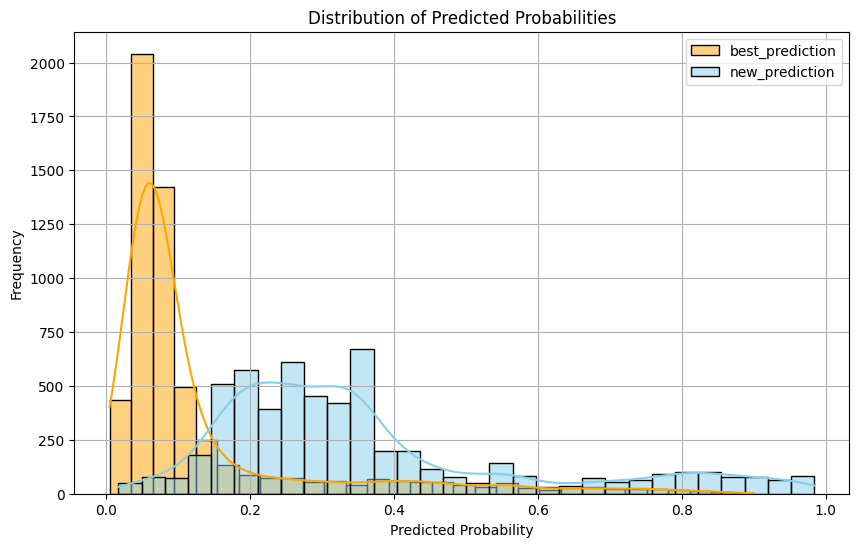

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(best_submission['berlangganan_deposito'], bins=30, kde=True, color='orange', label='best_prediction')
sns.histplot(val_prob, bins=30, kde=True, color='skyblue', label='new_prediction')
plt.title('Distribution of Predicted Probabilities')
plt.xlabel('Predicted Probability')
plt.ylabel('Frequency')
plt.grid(True)
plt.legend()
plt.show()